# 0. Load functions and set parameters

In [2]:
# %matplotlib notebook

import os, h5py, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import torch.nn as nn
import torch

from scipy import signal
from scipy.optimize import curve_fit
from scipy.stats import zscore

sys.path.append('../')
from visualize_functions import show_images, plot_curve, show_grid_plots, label_violinplot
from analyze_spot_functions import NormalizeData
from fitting_functions import load_curve, load_multiple_curves, detect_peaks, remove_outlier, smooth, fit_exp_function, analyze_curves
    
# from analyze_RHEED_spot_functions import show_metrics, Gaussian, generate_parameter_file, show_sound, show_fft_frequency, butter_filter, process_pass_filter
# from analyze_RHEED_intensity_functions import NormalizeData, trim_axes, show_images, show_plots
plt.rcParams.update(mpl.rcParamsDefault)

color_green = (27/255,158/255,119/255)
color_orange = (217/255,95/255,2/255)
color_purple = (117/255,112/255,179/255)

rc_plot = {'figure.figsize':(12,2.5),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 18,

          'xtick.labelsize': 14,
          'xtick.direction': 'in',
          'xtick.top': True,
          'xtick.bottom': True,
          'xtick.labelbottom': True,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 14,
          'ytick.direction': 'in',
          'ytick.right': True,
          'ytick.left': True,
          'ytick.labelleft': True,
          'ytick.labelright': False,

          'legend.fontsize': 10,
          'font.family': 'sans-serif'}

rc_img = {'figure.figsize':(8,8),
          'axes.facecolor':'white',
          'axes.grid': False,
          'axes.titlesize': 18,
          'axes.labelsize': 14,
          
          'xtick.labelsize': 12,
          'xtick.direction': 'in',
          'xtick.top': False,
          'xtick.bottom': False,
          'xtick.labelbottom': False,
          'xtick.labeltop': False,
          
          'ytick.labelsize': 12,
          'ytick.direction': 'in',
          'ytick.right': False,
          'ytick.left': False,
          'ytick.labelleft': False,
          'ytick.labelright': False,

          'legend.fontsize': 8,
          'font.family': 'sans-serif'}

ModuleNotFoundError: No module named 'torch'

# 1. Visualize the spots from collected data

In [ ]:
plt.rcParams.update(rc_img)

imgs = []
region = [(45, 85, 360, 450), (140, 170, 408, 470), (220, 265, 355, 455)]
with h5py.File('/scratch/yichen/RHEED_data/STO_STO_test7_06292022.h5', mode='r') as h5:
    spots_name = ['spot1', 'spot2', 'spot3']
    img_all_spots = np.array(h5['growth_2'][20])
    plt.imsave('../figures/1.test7_all_spots.png', img_all_spots)
    
    imgs.append(img_all_spots)
    for i, sn in enumerate(spots_name):
        imgs.append(NormalizeData(img_all_spots[region[i][0]:region[i][1], region[i][2]:region[i][3]]).astype(np.float32))
        plt.imsave('../figures/1.test7_'+sn+'.png', imgs[i+1])

show_images(imgs, ['all spots']+spots_name, img_per_row=4, img_height=0.1, colorbar=True)

# 2. Visualize RHEED intensity oscillation

## 2.1 Treated substrate(step width=0.43±0.04μm)

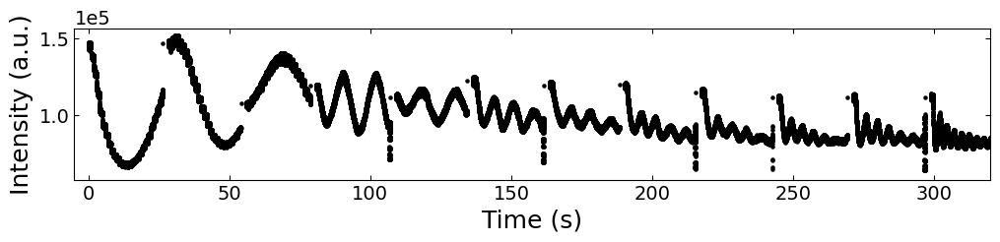

In [3]:
plt.rcParams.update(rc_plot)

h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3, 'growth_6':5, 
               'growth_7':5, 'growth_8':7, 'growth_9':7, 'growth_10':9, 'growth_11':9, 'growth_12':15}
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, 'spot_2', 'img_intensity', x_start=0, interval=1000)
plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2), xlim=[-5,320],
           save_path='../figures/3.sample1_intensity.png')

## 2.2 Treated substrate(step width=0.11±0.01μm)

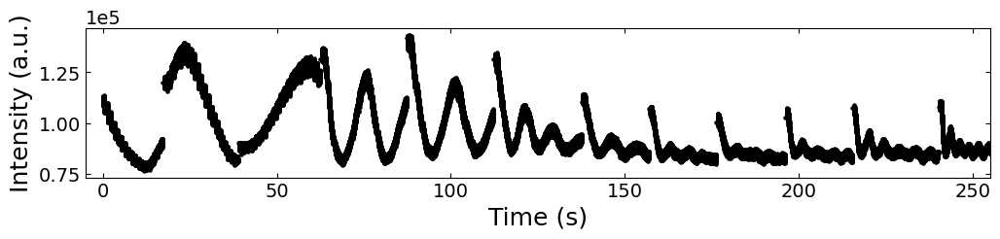

In [4]:
plt.rcParams.update(rc_plot)

h5_para_file = '../../data/test7_gaussian_fit_parameters_all.h5'
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3, 
               'growth_6':5, 'growth_7':5, 'growth_8':7, 'growth_9':7, 'growth_10':9, 
               'growth_11':9, 'growth_12':15}
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, 'spot_2', 'img_intensity', x_start=0, interval=200)
plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2), xlim=[-5,255],
           save_path='../figures/3.sample2_intensity.png')           

## 2.3 Untreated substrate(step width=0.28±0.03μm)

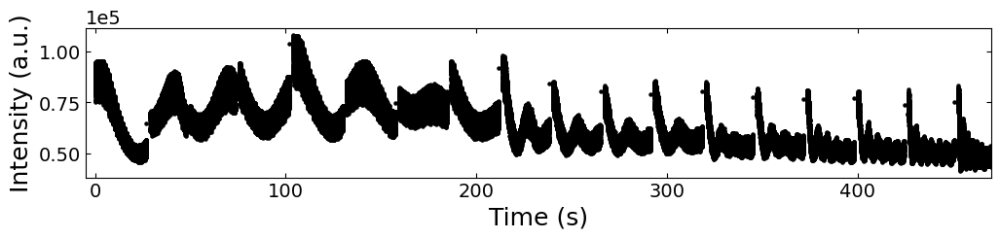

In [5]:
plt.rcParams.update(rc_plot)

h5_para_file = '../../data/test9_gaussian_fit_parameters_all.h5'
growth_dict = {'growth_01':1, 'growth_02':1, 'growth_03':1, 'growth_04':1, 'growth_05':1, 
               'growth_06':1, 'growth_07':1, 'growth_08':1, 'growth_09':3, 'growth_10':3, 
               'growth_11':3, 'growth_12':3, 'growth_13':5, 'growth_14':5, 'growth_15':7, 
               'growth_16':7, 'growth_17':9, 'growth_18':15}
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, 'spot_2', 'img_intensity', x_start=0, interval=1000)
plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2), xlim=[-5,470],
           save_path='../figures/3.sample3_intensity.png')           

# 3. Growth mechanism analysis - first unit cell of sample 1

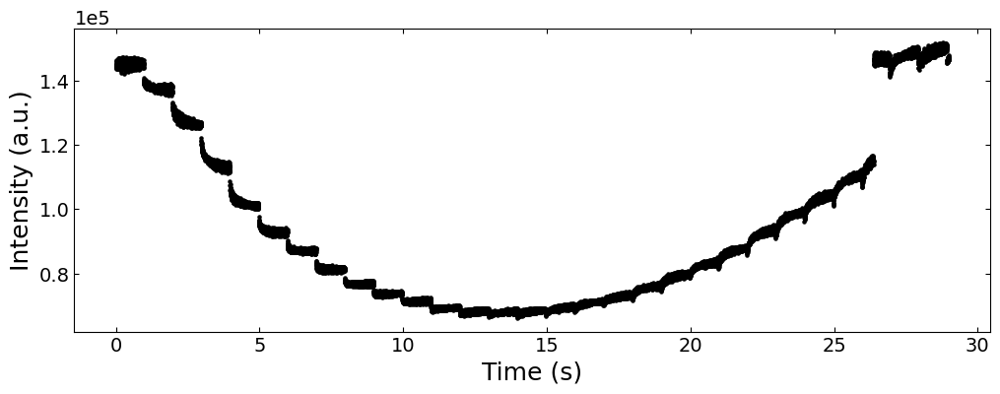

In [6]:
plt.rcParams.update(rc_plot)

h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
# title = 'Treated substrate(step width=0.43±0.04μm)'
growth_dict = {'growth_1.':1, 'growth_2':1}
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, 'spot_2', 'img_intensity', x_start=0, interval=0)
x_sample = x_all[x_all<29]
y_sample = y_all[x_all<29]
plot_curve(x_sample, y_sample, plot_type='scatter', xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,4))

# 4. Analyze the Recovery Curve

## 4.1 Fitting RHEED Intensity with Exponential Function for Intensity Magnitude and Characteristic Time

In [7]:
spot = 'spot_2'
metric = 'img_intensity'
interval = 1000
camera_freq = 500
fit_settings = {'savgol_window_order': (15, 3), 'pca_component': 10, 'I_diff': 15000, 
                'unify':False, 'bounds':[0.001, 1], 'p_init':[0.1, 0.4, 0.1]}

### 4.1.1 Treated substrate (step width=0.43±0.04μm) - growth_1 - fitting with sklearn functions

growth_1. :


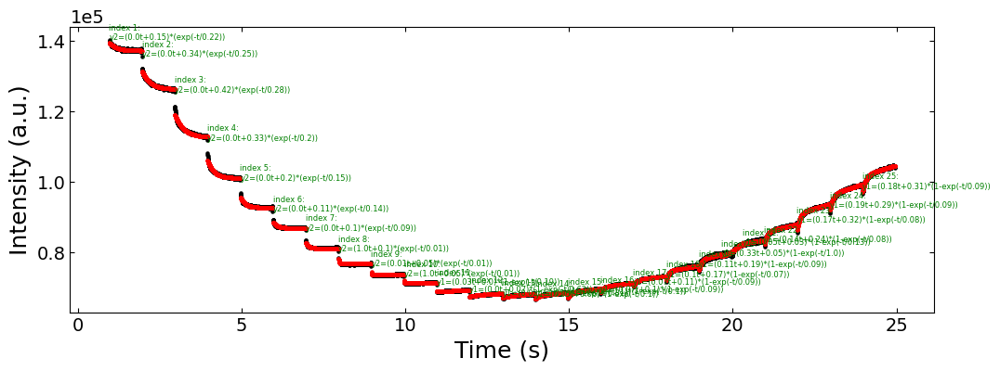

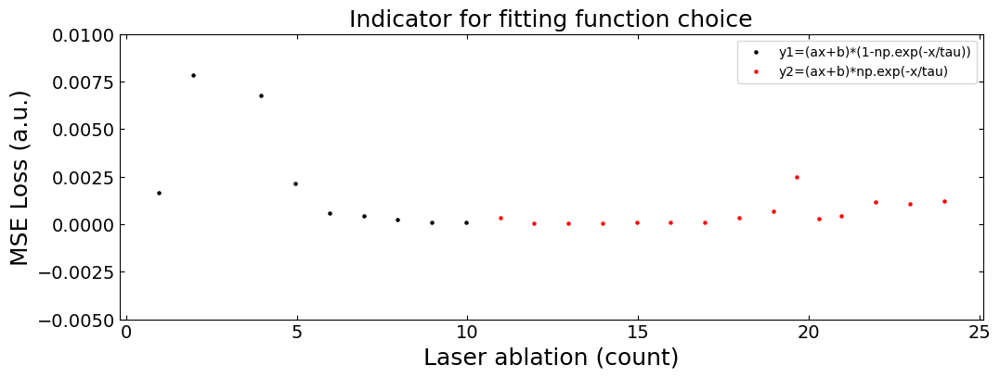

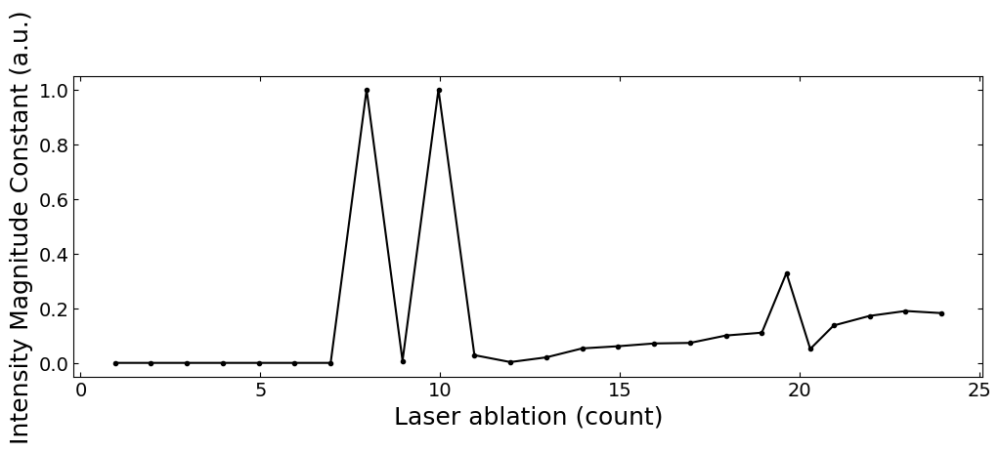

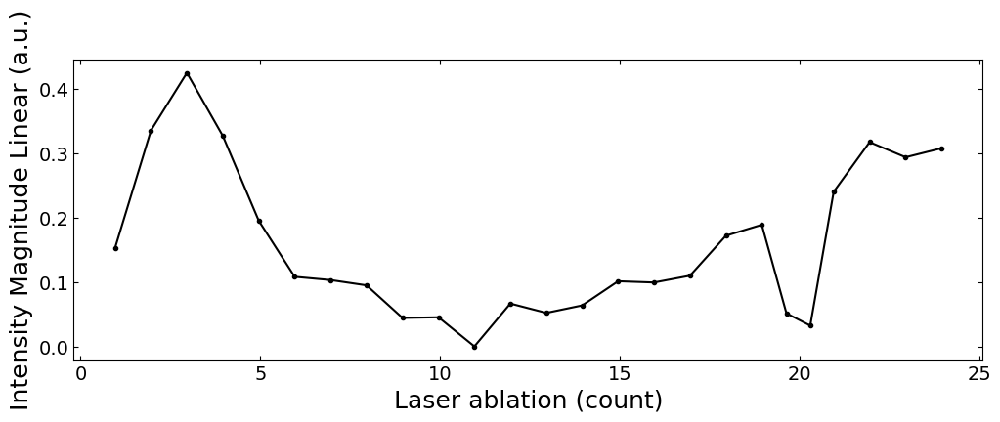

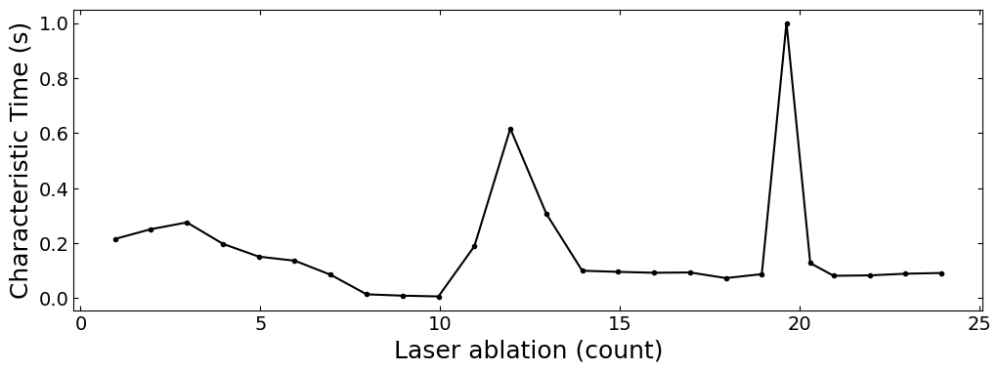

Fitting curves for normalized data:


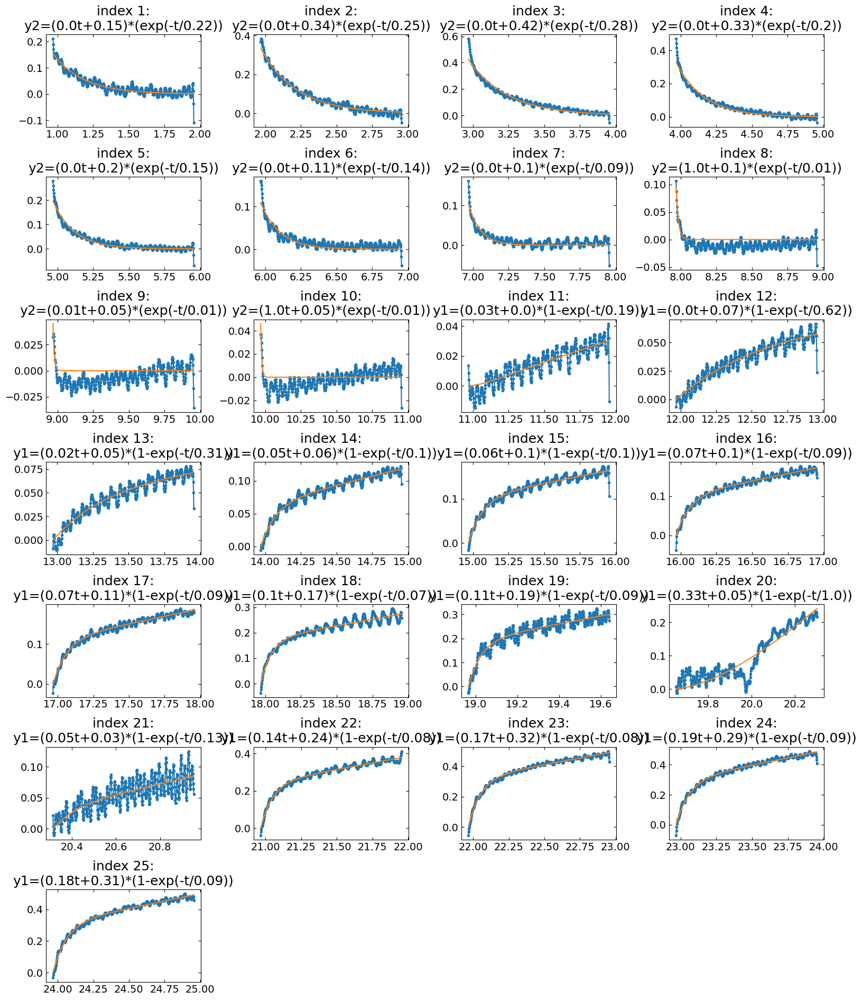

Fitting curves for raw data:


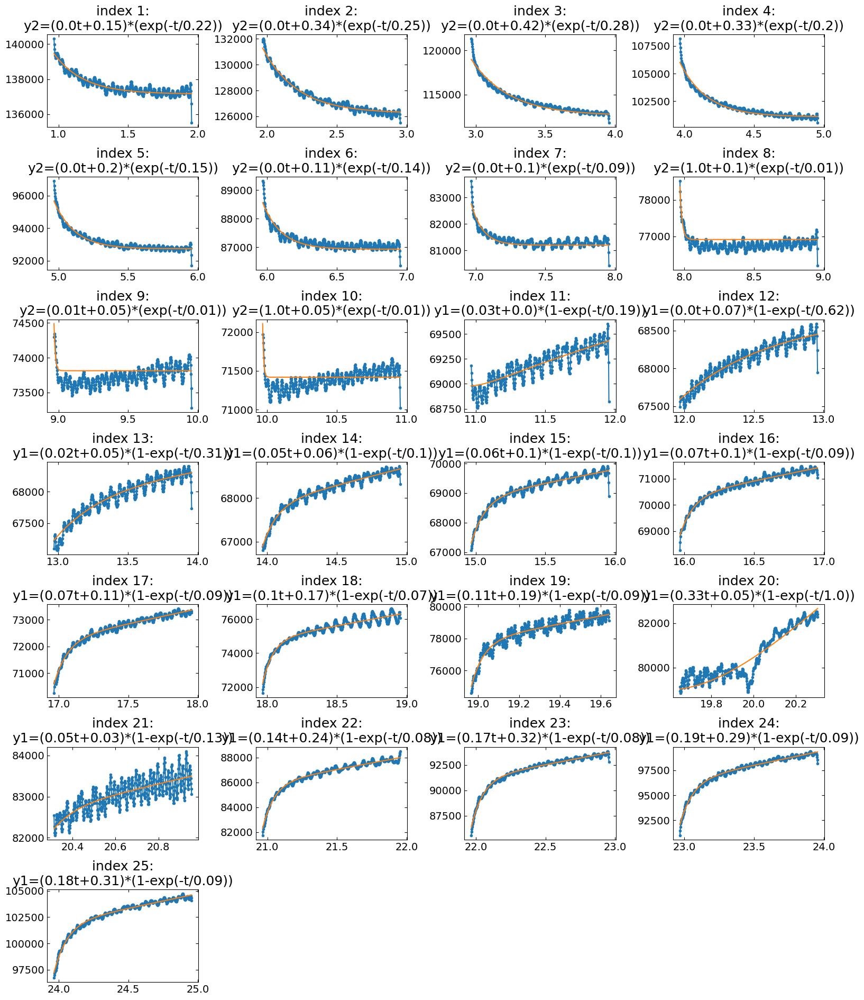

growth_2 :


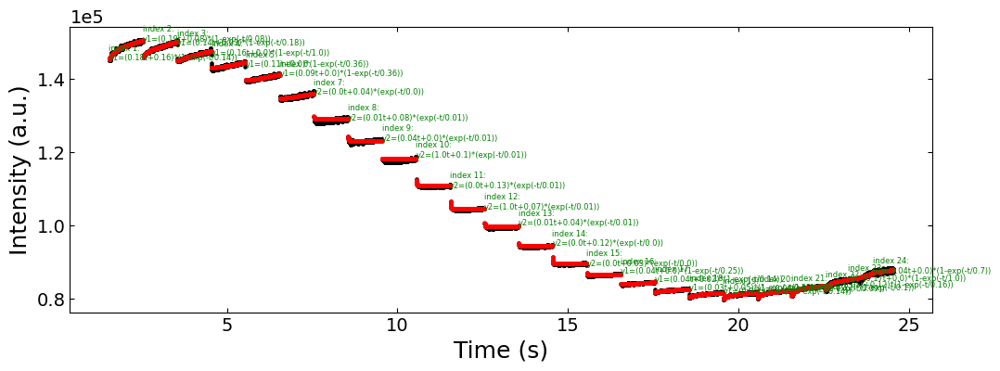

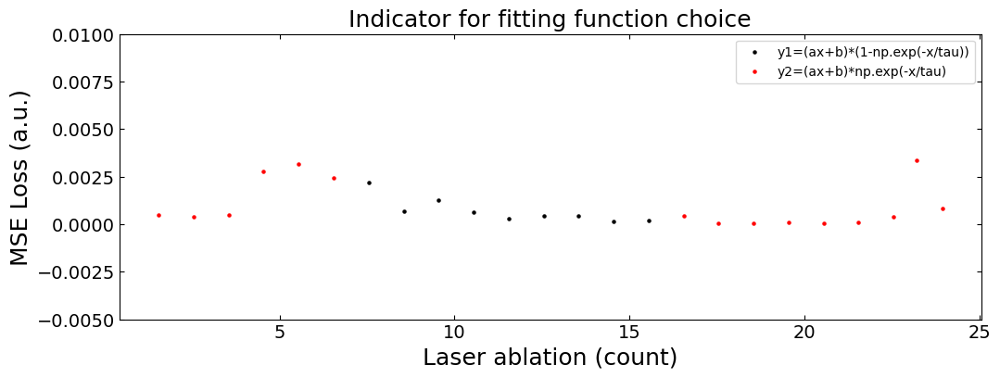

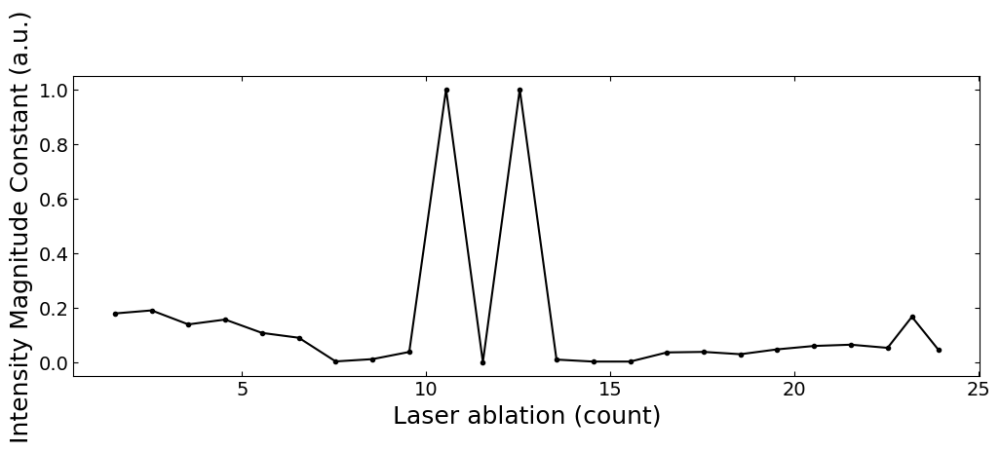

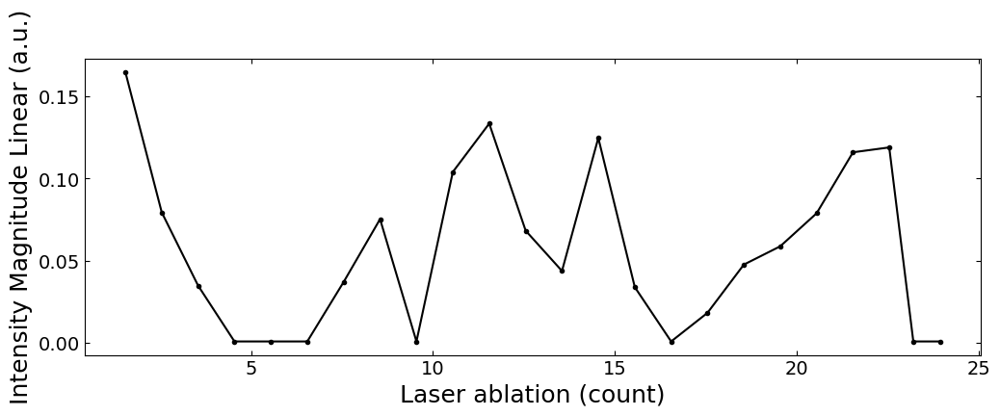

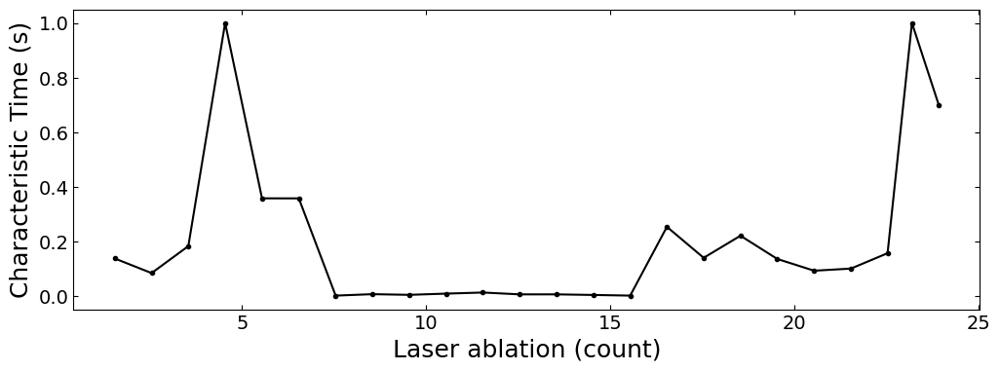

Fitting curves for normalized data:


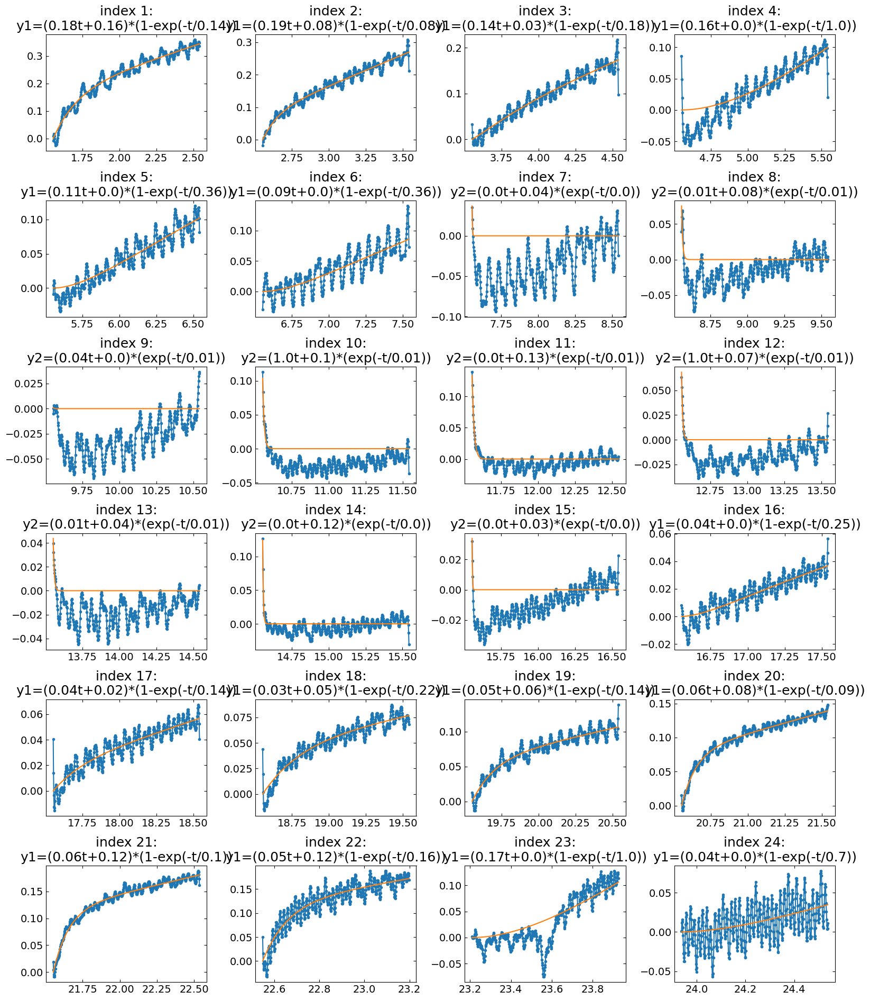

Fitting curves for raw data:


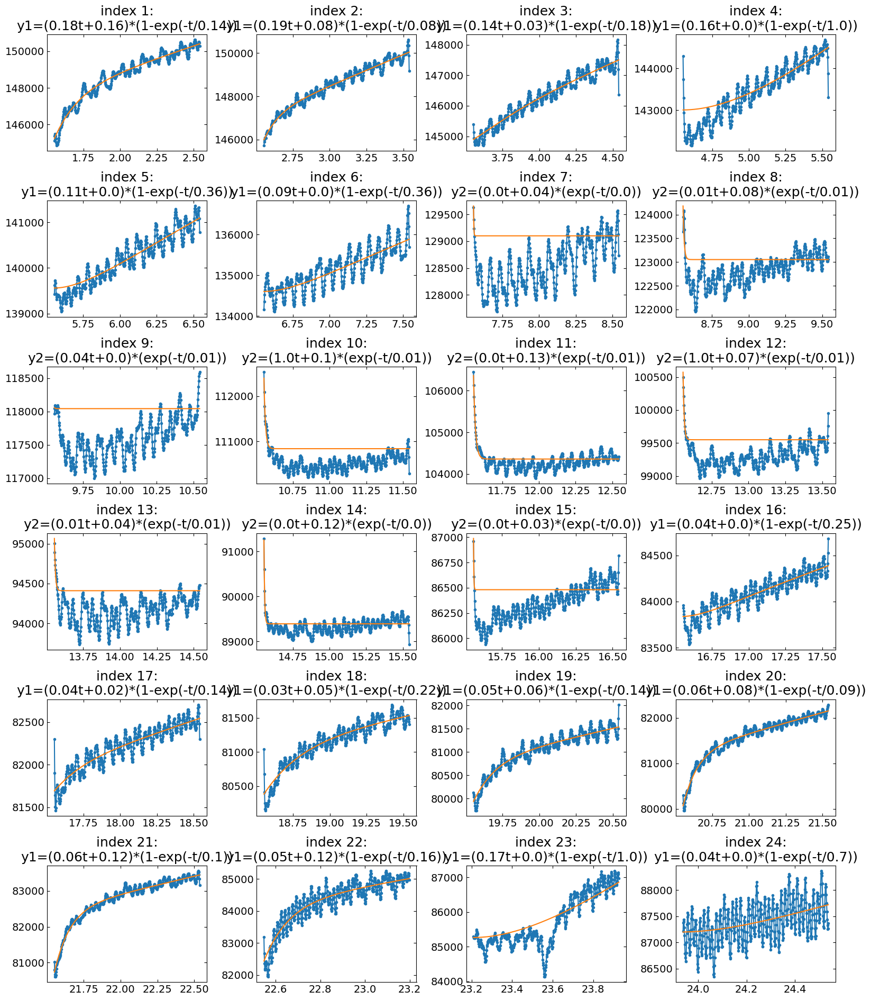

growth_3 :


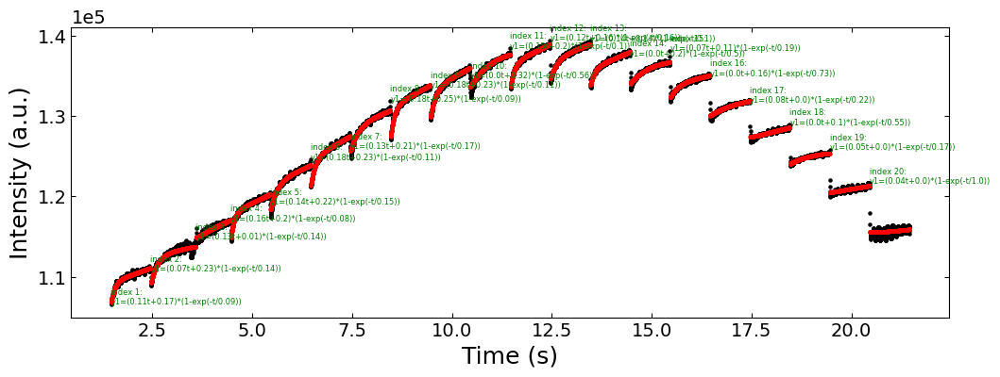

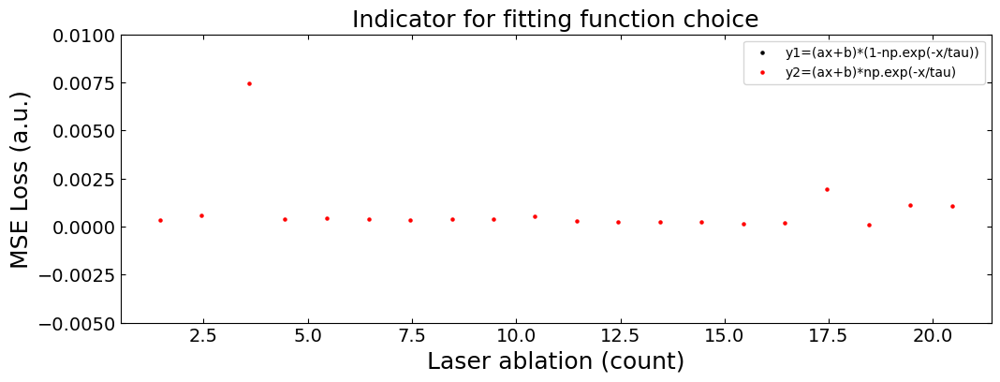

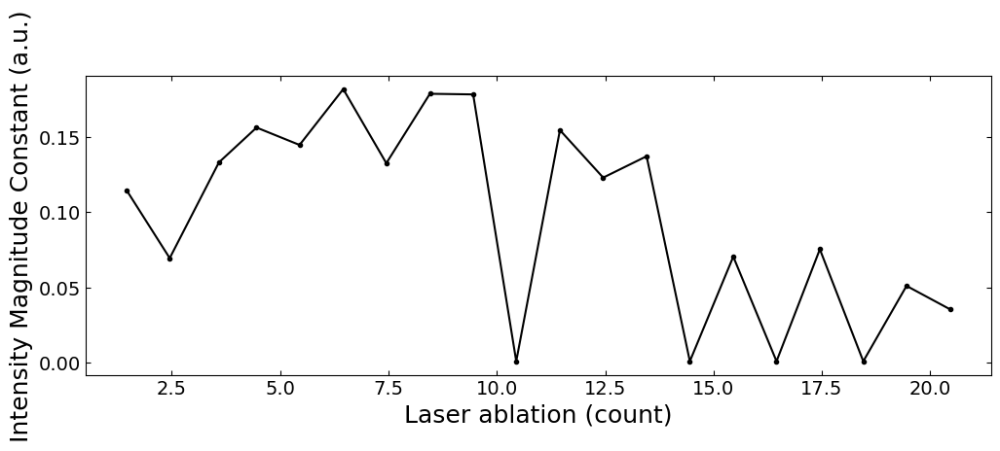

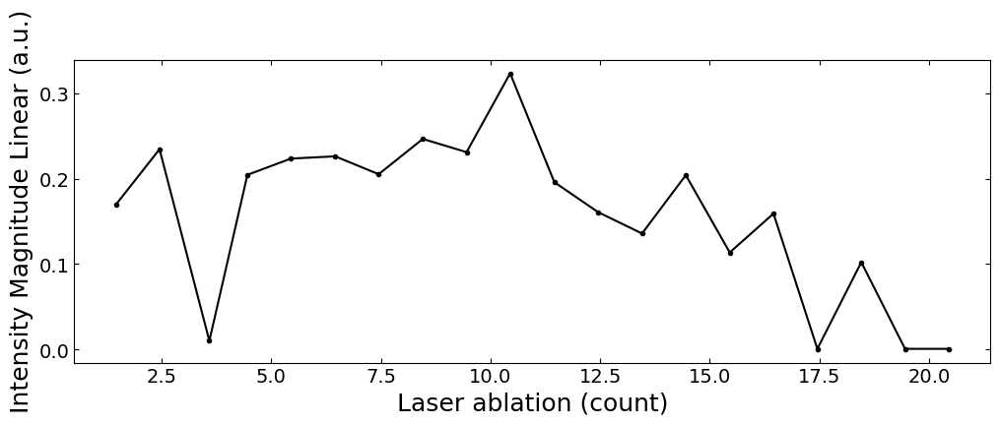

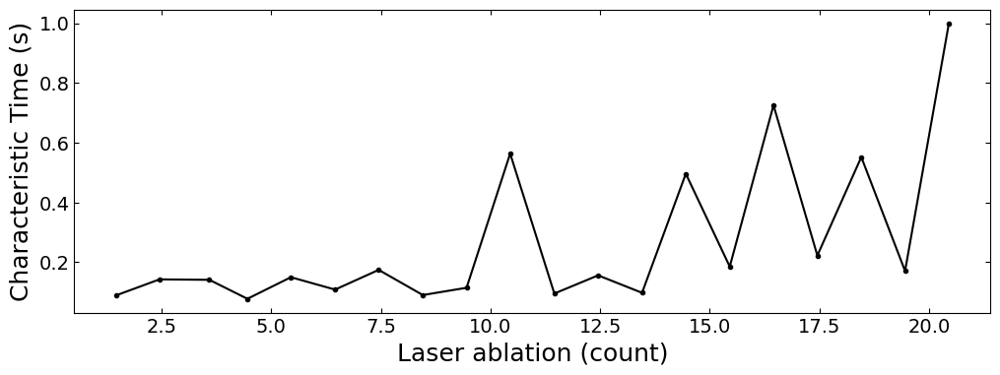

Fitting curves for normalized data:


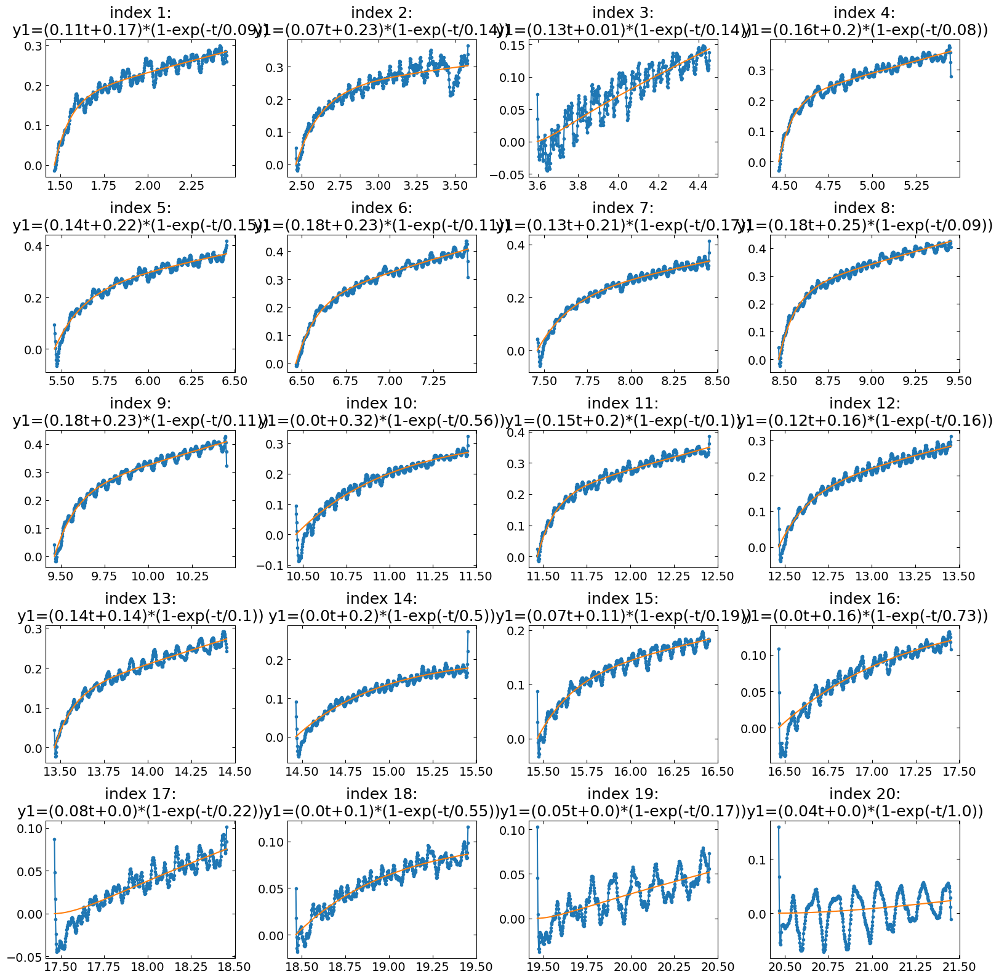

Fitting curves for raw data:


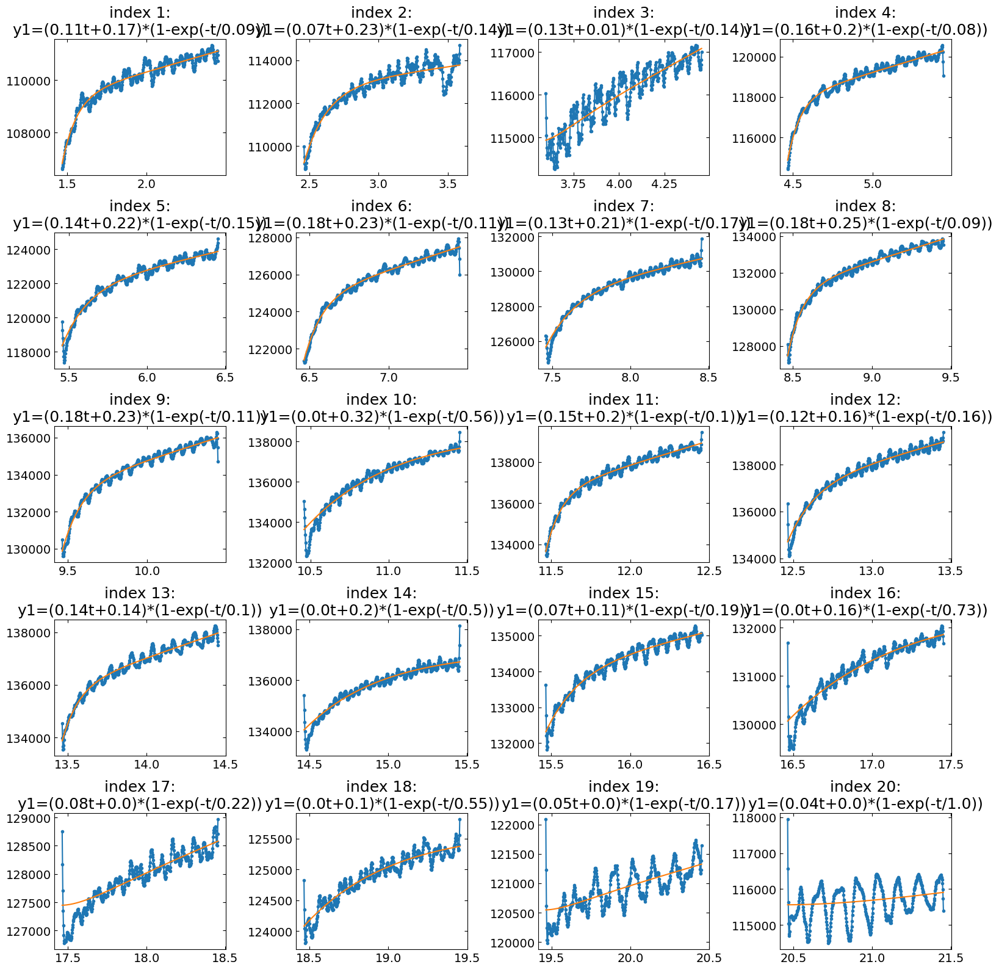

growth_4 :


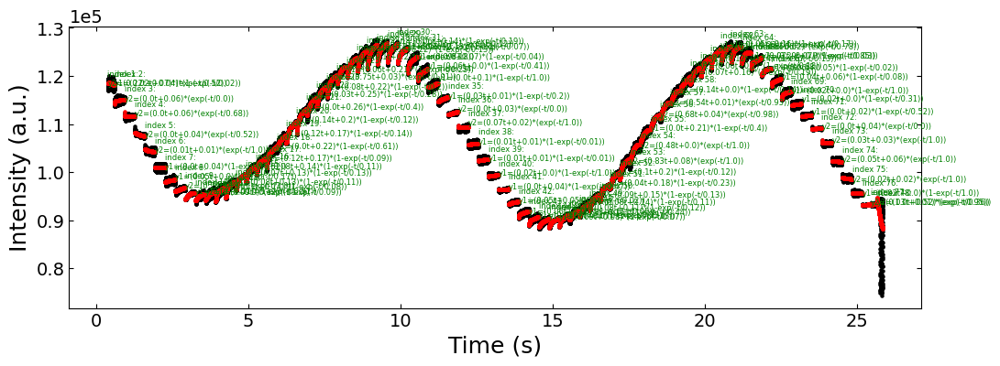

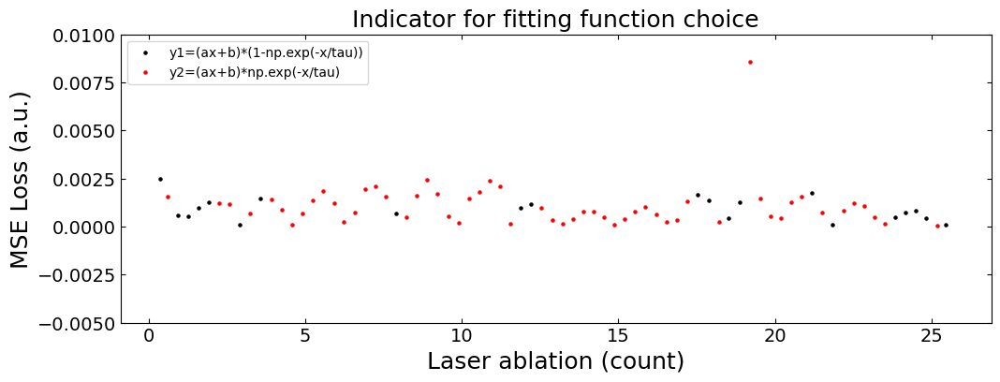

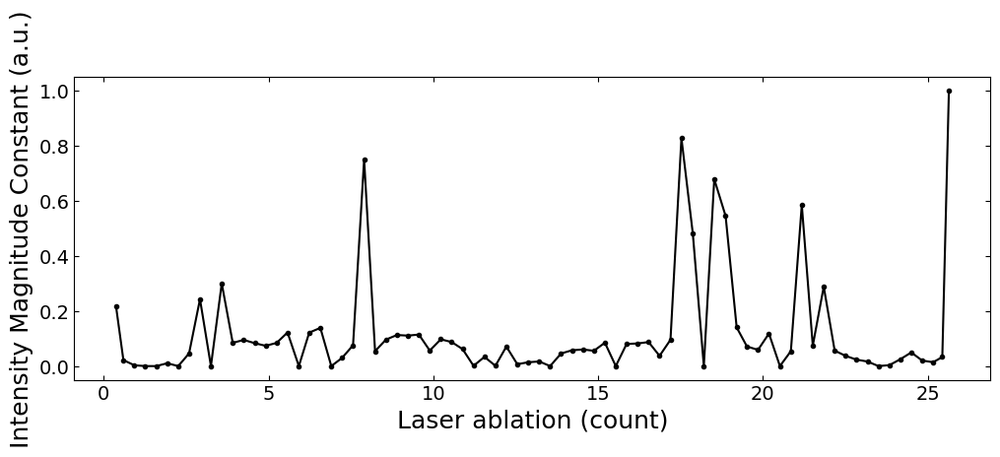

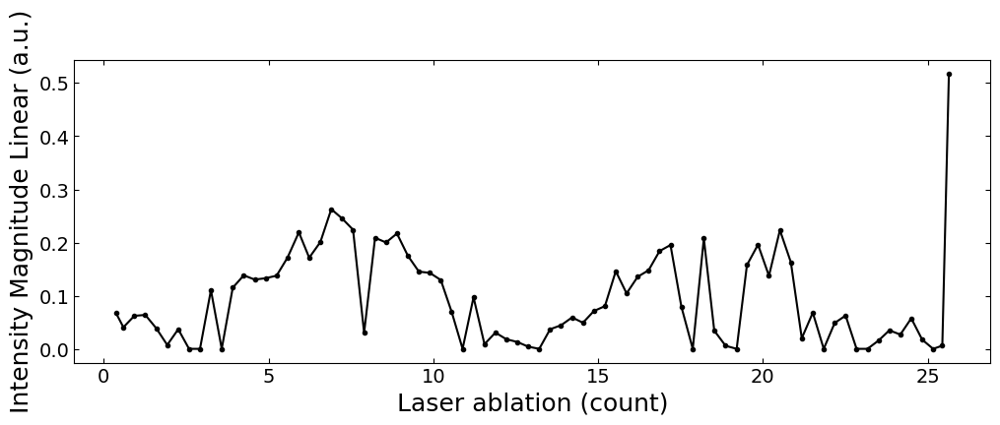

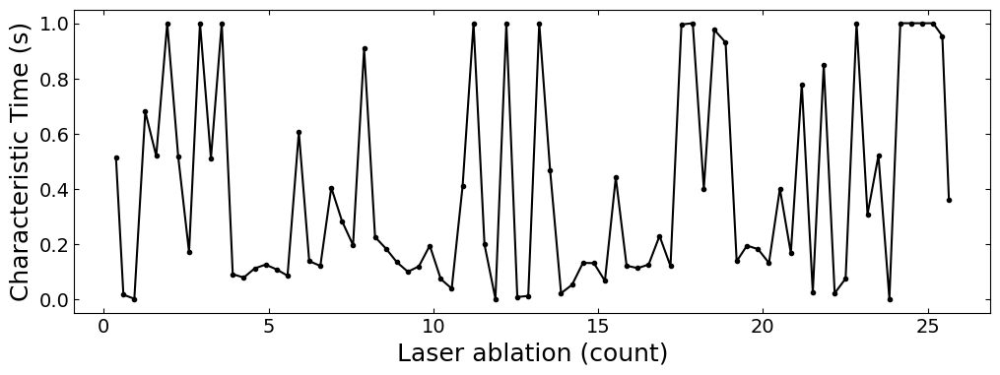

Fitting curves for normalized data:


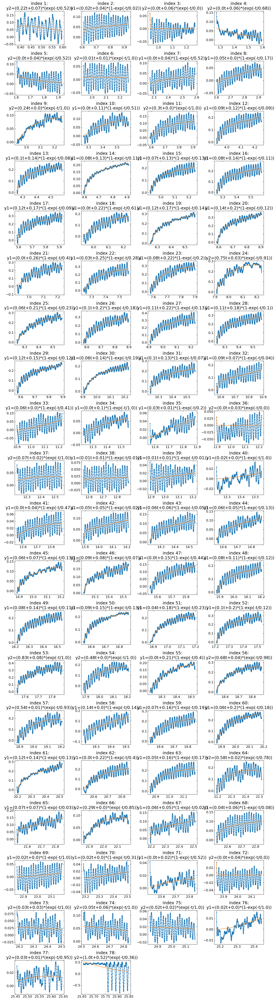

Fitting curves for raw data:


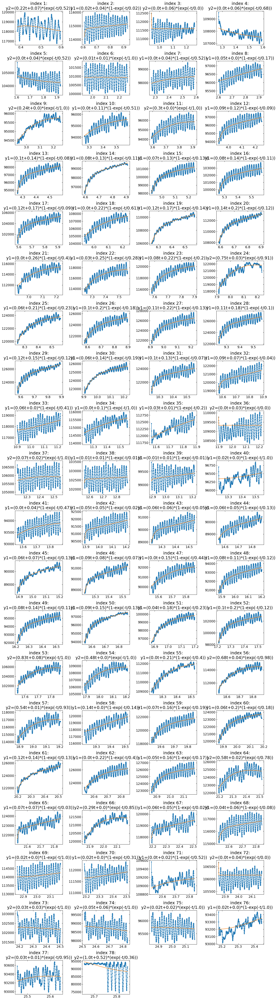

growth_5 :


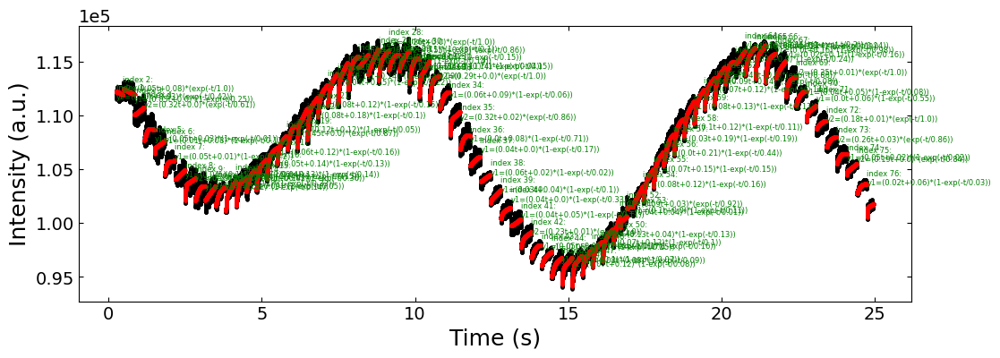

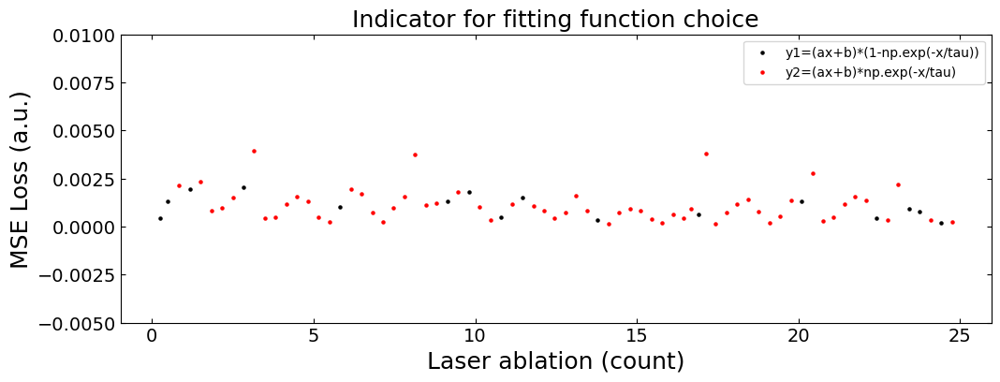

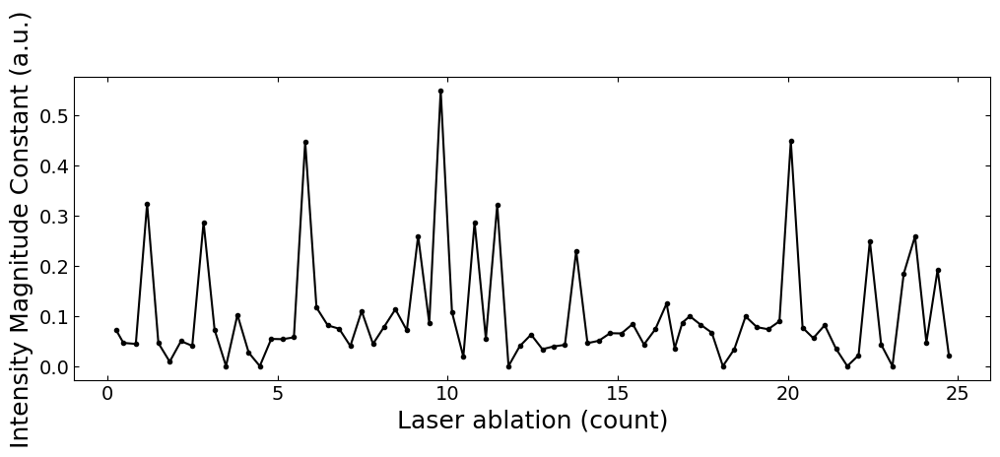

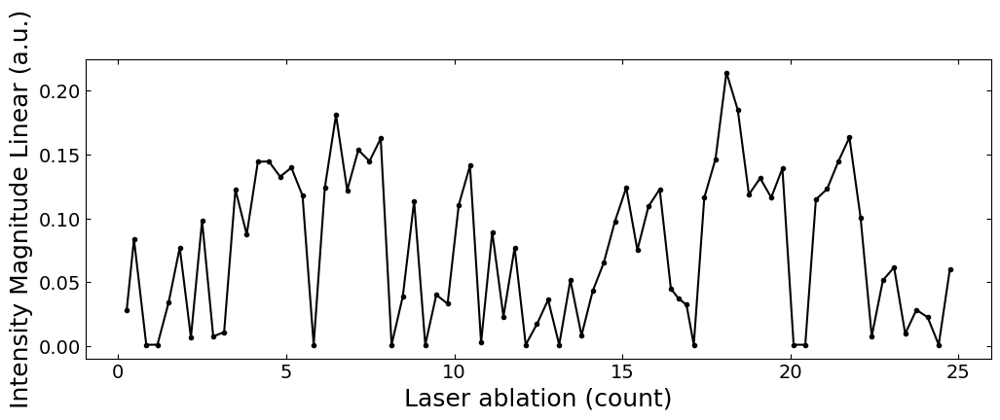

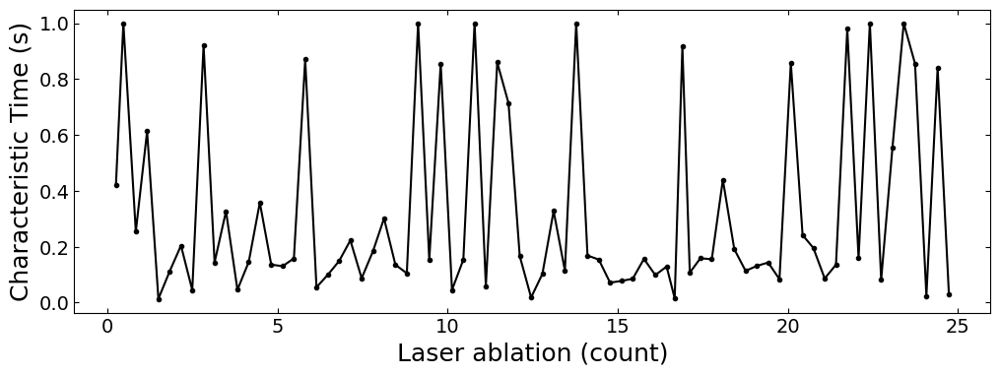

Fitting curves for normalized data:


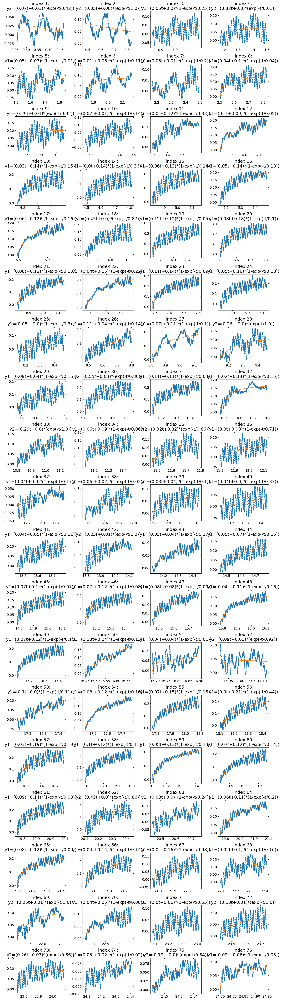

Fitting curves for raw data:


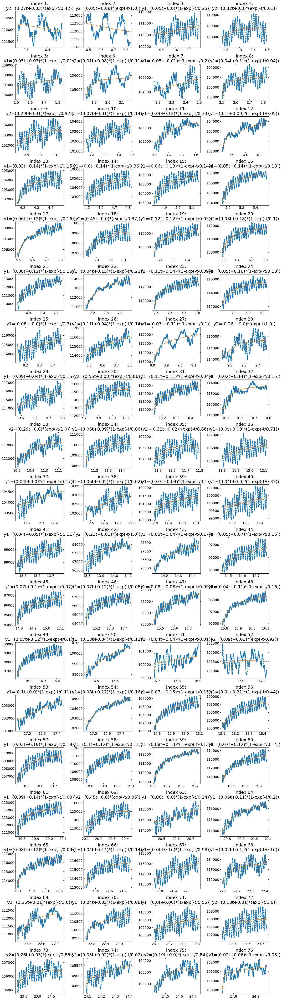

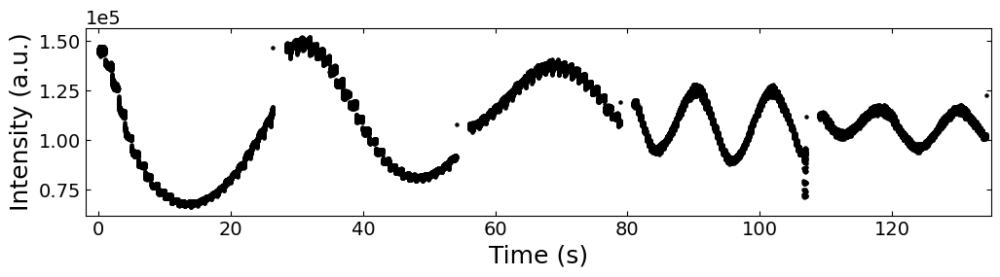

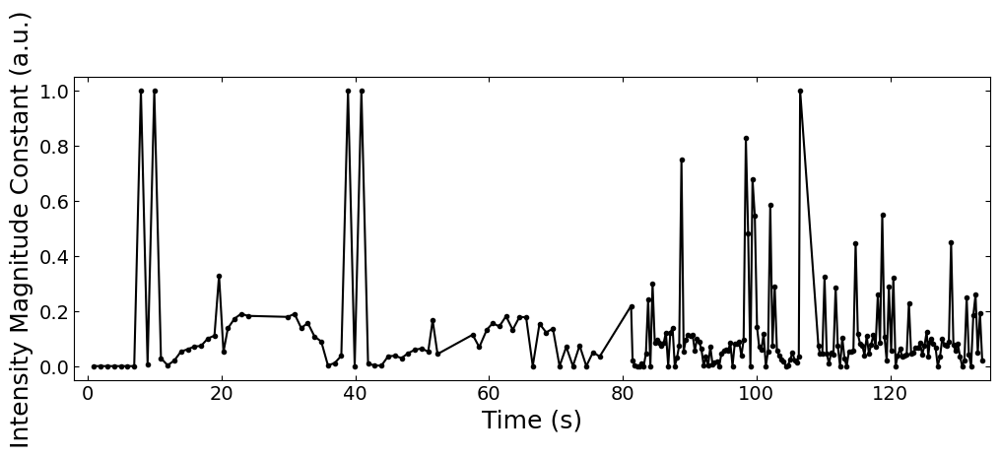

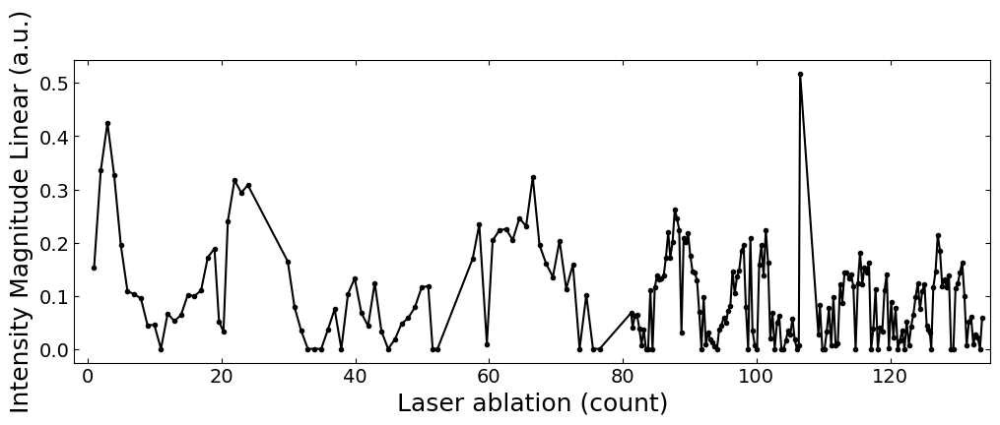

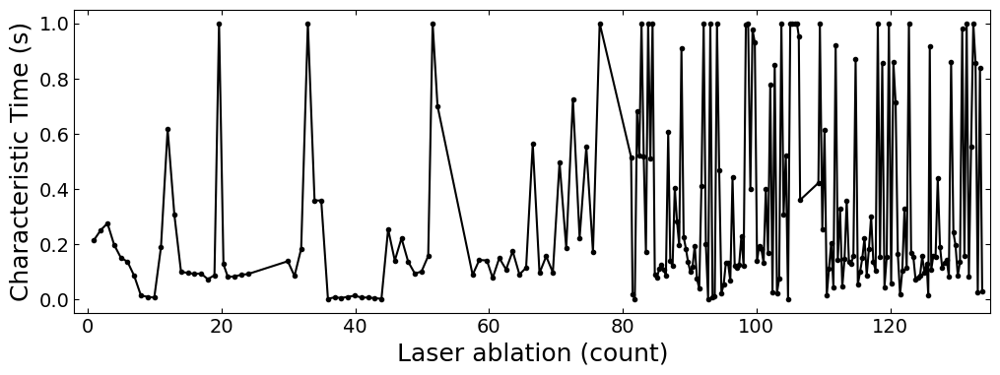

MSE loss for classic fitting is: 0.001107290934964858


In [8]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
visualize = True
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

## 4.2 Collect diffusion time constant for three samples

### 4.2.1 Treated substrate (step width=0.43±0.04μm)

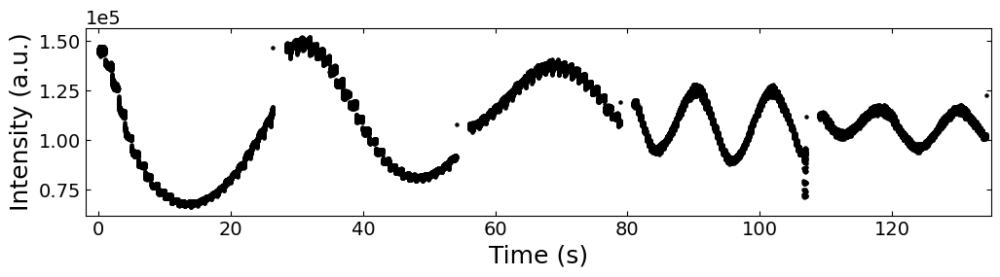

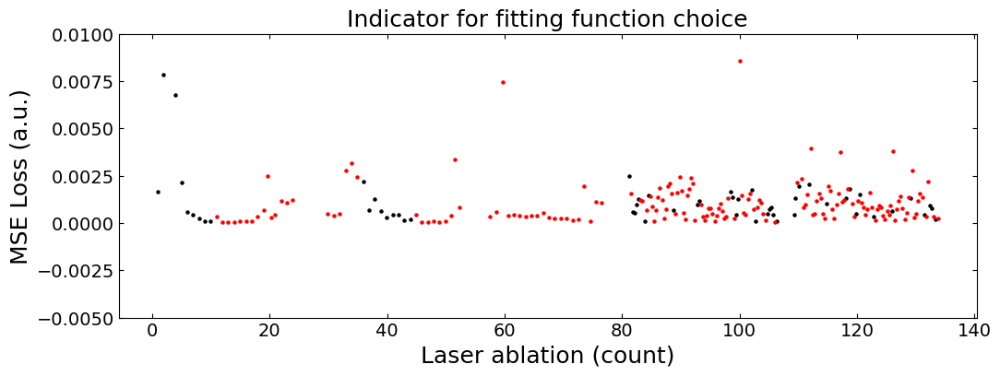

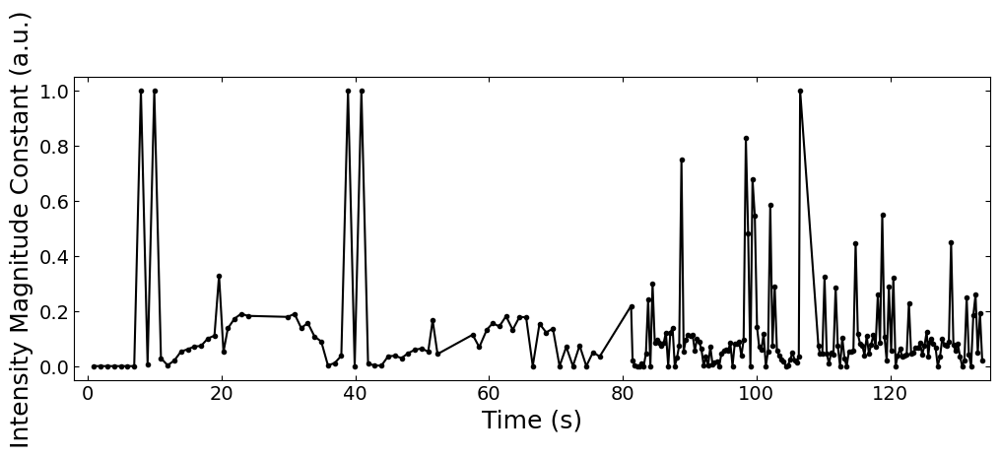

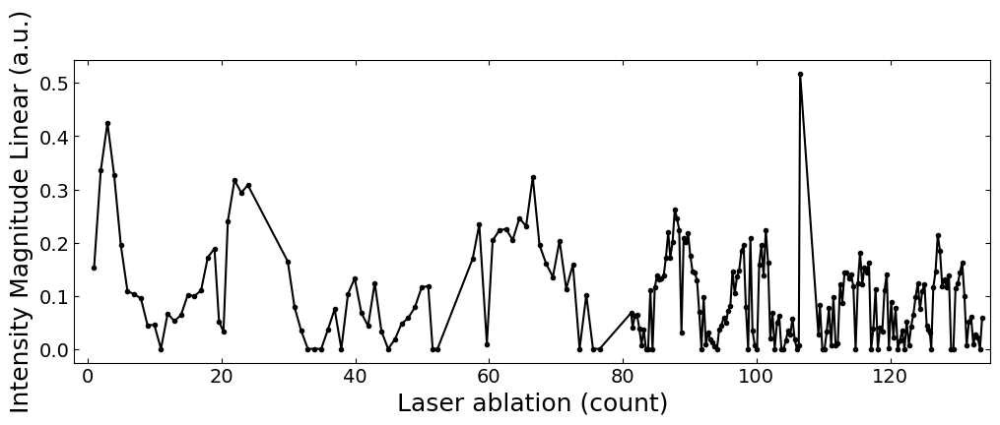

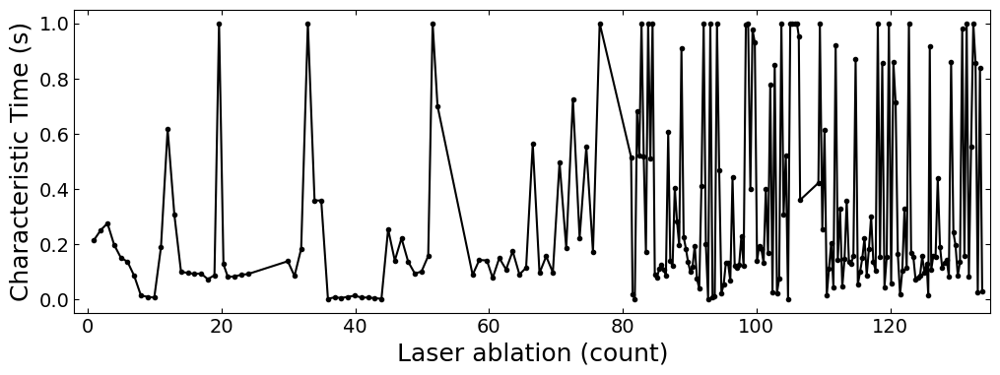

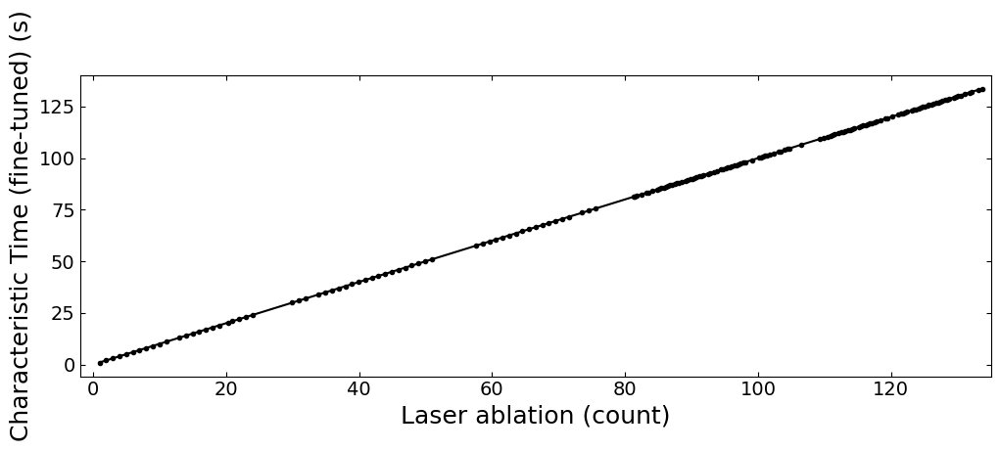

MSE loss for classic fitting is: 0.001107290934964858


In [9]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test6_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.01),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, x_coor_all_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test6_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

### 4.2.2 Treated substrate (step width=0.11±0.01μm)

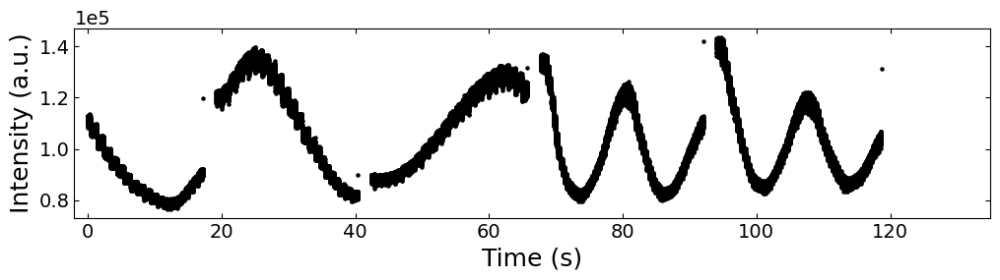

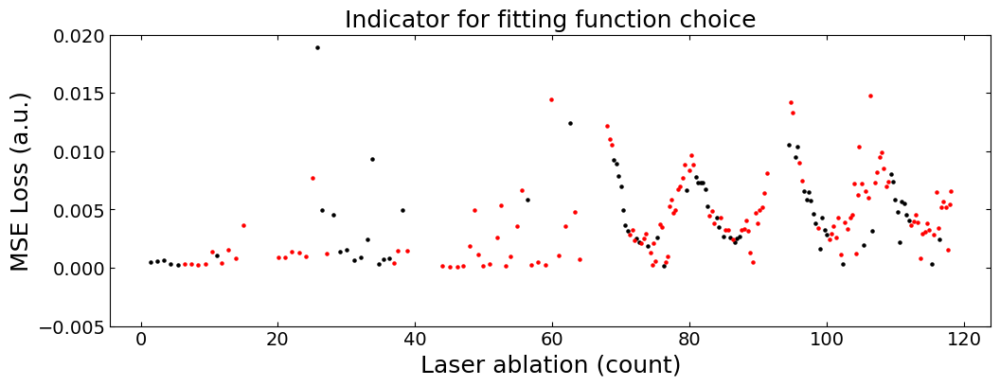

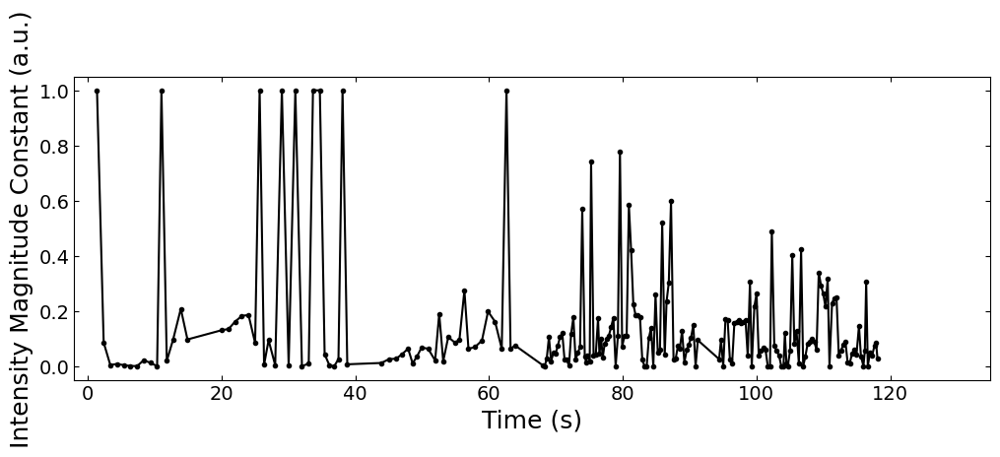

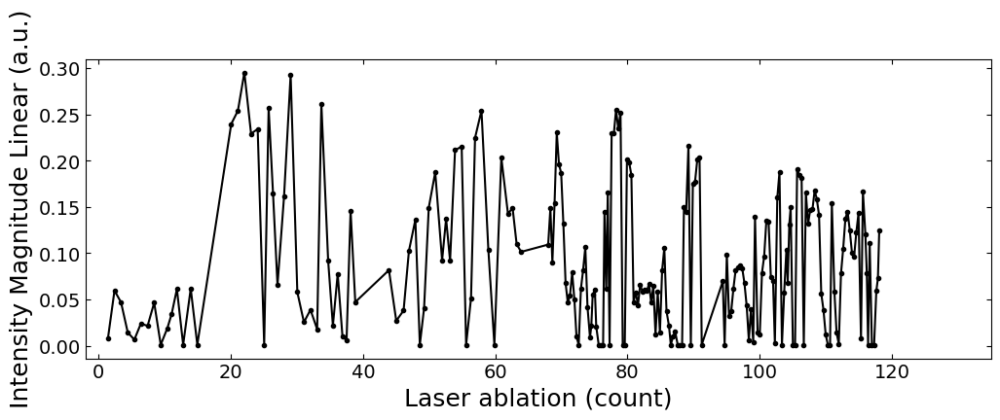

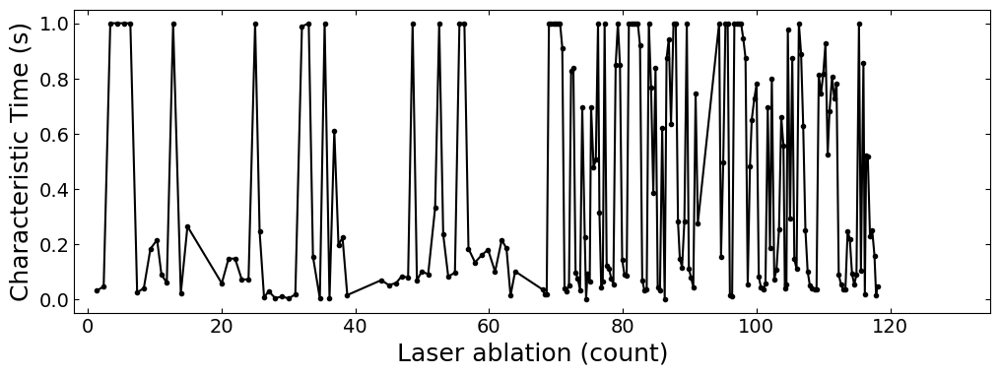

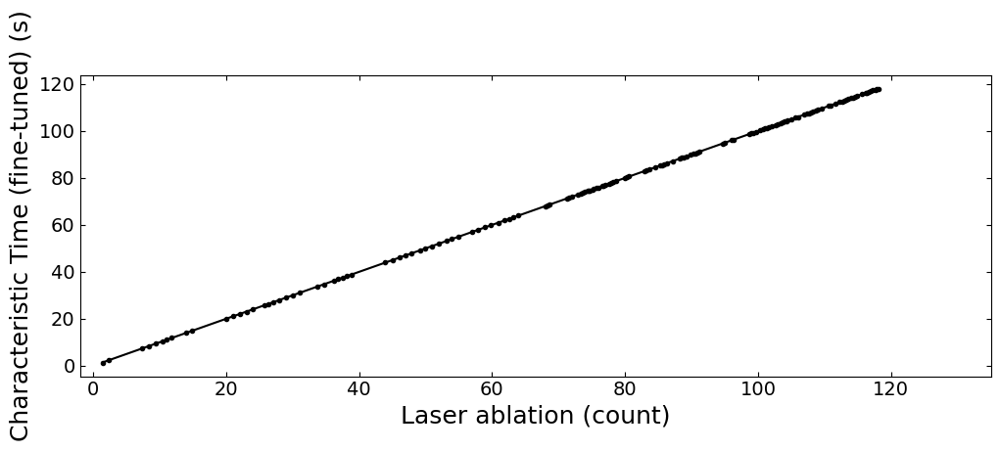

MSE loss for classic fitting is: 0.0037753500633249124


In [10]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_1.':1, 'growth_2':1, 'growth_3':1, 'growth_4':3, 'growth_5':3}
h5_para_file = '../../data/test7_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.02),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, x_coor_all_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test7_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

### 4.2.3 Untreated substrate (step width=0.28±0.03μm)

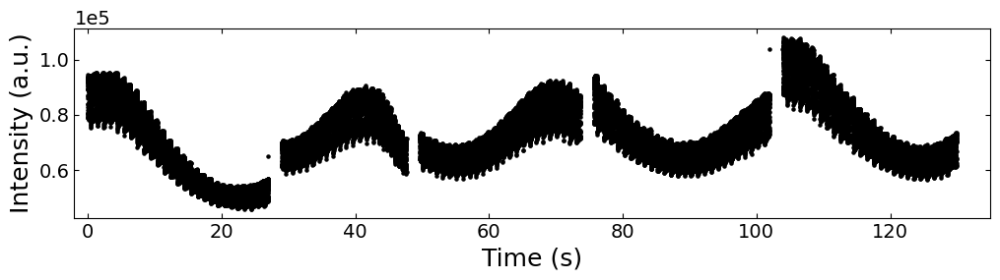

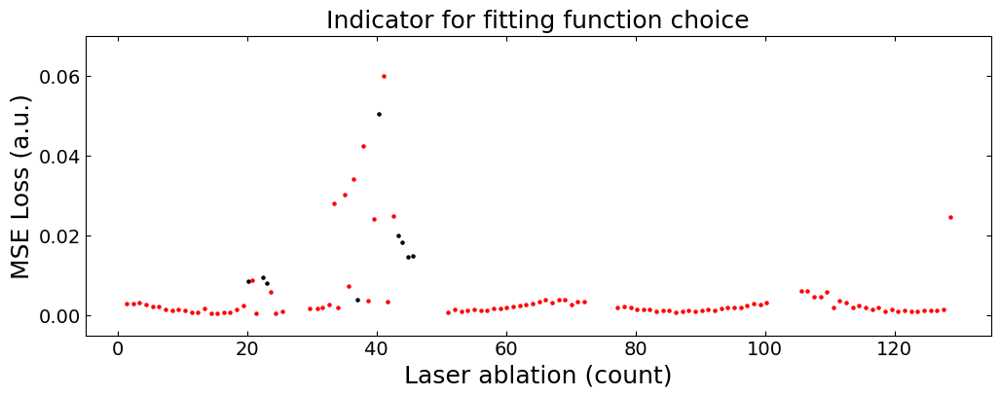

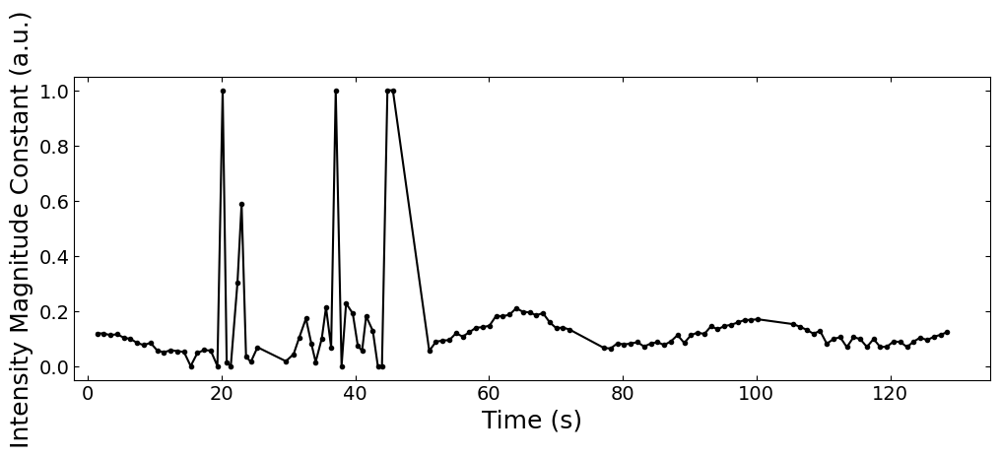

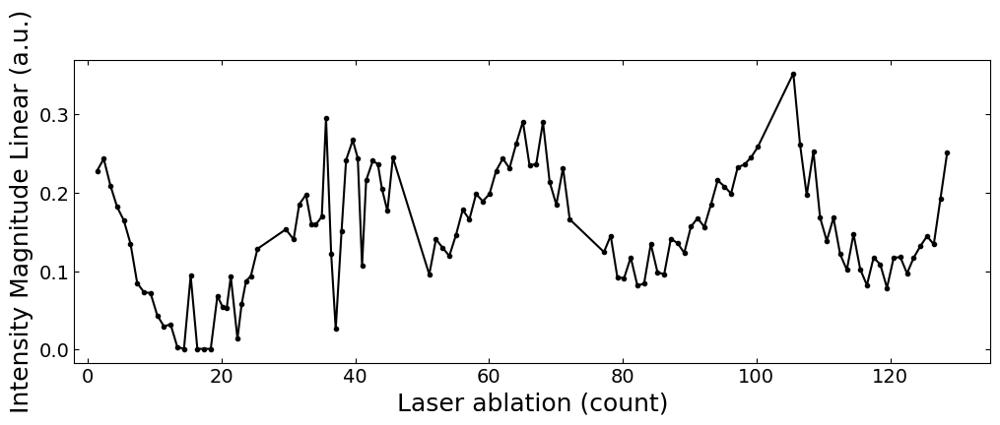

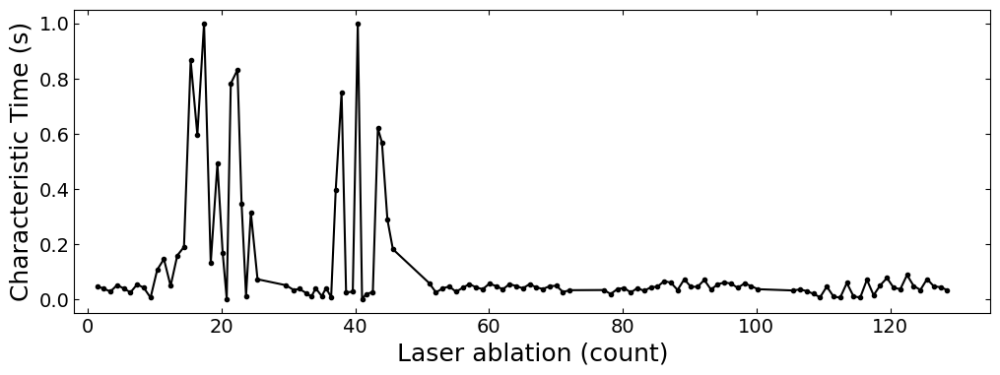

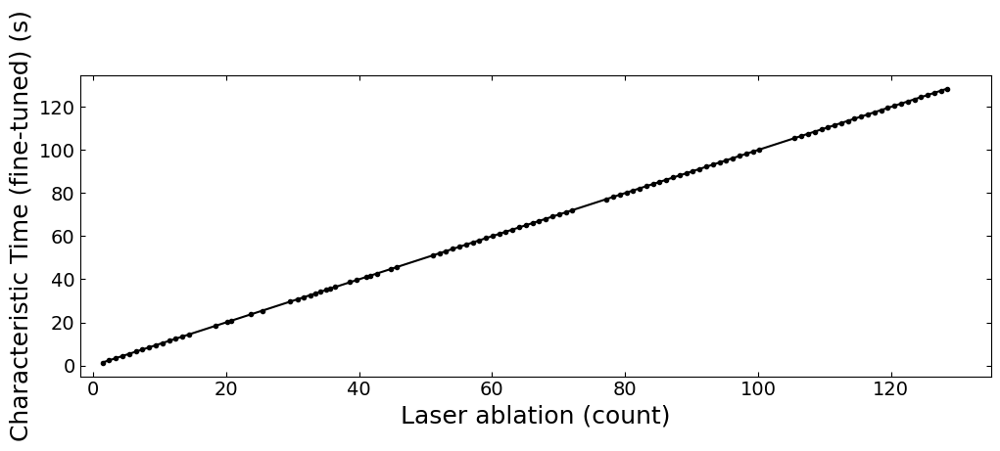

MSE loss for classic fitting is: 0.004981207188287807


In [11]:
plt.rcParams.update(rc_plot)
growth_dict = {'growth_01':1, 'growth_02':1, 'growth_03':1, 'growth_04':1, 'growth_05':1}
h5_para_file = '../../data/test9_gaussian_fit_parameters_all.h5'
visualize = False
x_all, y_all = load_multiple_curves(h5_para_file, growth_dict, spot, metric, x_start=0, interval=interval)

parameters_all, x_coor_all, info = analyze_curves(h5_para_file, growth_dict, spot, metric, camera_freq=camera_freq, 
                                                  interval=interval,  visualize=visualize, fit_settings=fit_settings)
[xs_all, ys_all, ys_fit_all, ys_nor_all, ys_nor_fit_all, labels_all, losses_all] = info

plot_curve(x_all, y_all, xlabel='Time (s)', ylabel='Intensity (a.u.)', figsize=(12,2.5), xlim=(-2, 135))

x_y1 = x_coor_all[losses_all[:,0]>losses_all[:,1]]
loss_y1 = losses_all[:,0][losses_all[:,0]>losses_all[:,1]]
x_y2 = x_coor_all[losses_all[:,0]<losses_all[:,1]]
loss_y2 = losses_all[:,1][losses_all[:,0]<losses_all[:,1]]
plot_curve(x_y1, loss_y1, curve_x_fit=x_y2, curve_y_fit=loss_y2, plot_type='scatter', ylim=(-0.005, 0.07),
           xlabel='Laser ablation (count)', ylabel='MSE Loss (a.u.)', yaxis_style='linear', 
           figsize=(12, 4), title='Indicator for fitting function choice')

plot_curve(x_coor_all, parameters_all[:,0], plot_type='lineplot', xlabel='Time (s)', ylabel='Intensity Magnitude Constant (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,1], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Intensity Magnitude Linear (a.u.)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
plot_curve(x_coor_all, parameters_all[:,2], plot_type='lineplot', xlabel='Laser ablation (count)', ylabel='Characteristic Time (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))

x_coor_all_clean, tau_test6_clean = remove_outlier(x_coor_all, parameters_all[:,2], 0.9)
tau_test6_clean = smooth(tau_test6_clean, 5)
plot_curve(x_coor_all_clean, x_coor_all_clean, plot_type='lineplot', xlabel='Laser ablation (count)', 
           ylabel='Characteristic Time (fine-tuned) (s)', 
           yaxis_style='linear', figsize=(12, 4), xlim=(-2, 135))
print('MSE loss for classic fitting is:', nn.MSELoss()(torch.tensor(np.concatenate(ys_nor_all, 0)), torch.tensor(np.concatenate(ys_nor_fit_all, 0))).item())

x_coor_all = np.expand_dims(x_coor_all, 1)
np.save('../saved_data/test9_fitting_results(sklearn).npy', np.concatenate([x_coor_all, parameters_all], axis=1))

## 4.3 Summary of diffusion time constant

### 4.3.1 Violinplot 

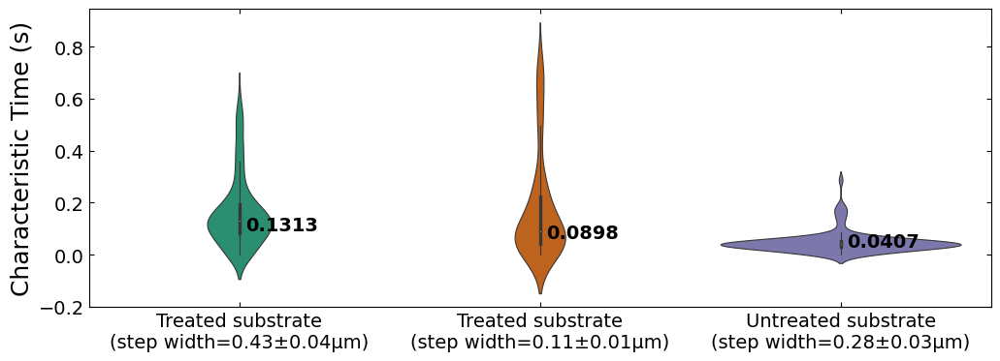

In [12]:
x_test6_sklearn, tau_test6_sklearn = np.swapaxes(np.load('../saved_data/test6_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test7_sklearn, tau_test7_sklearn = np.swapaxes(np.load('../saved_data/test7_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]
x_test9_sklearn, tau_test9_sklearn = np.swapaxes(np.load('../saved_data/test9_fitting_results(sklearn).npy'), 0, 1)[[0,-1]]

x_test6_sklearn, tau_test6_sklearn = remove_outlier(x_test6_sklearn, tau_test6_sklearn, 0.9)
x_test7_sklearn, tau_test7_sklearn = remove_outlier(x_test7_sklearn, tau_test7_sklearn, 0.9)
x_test9_sklearn, tau_test9_sklearn = remove_outlier(x_test9_sklearn, tau_test9_sklearn, 0.9)

data = [tau_test6_sklearn, tau_test7_sklearn, tau_test9_sklearn]
fig, ax = plt.subplots(figsize=(12, 4))

titles = ['Treated substrate\n(step width=0.43±0.04μm)',
          'Treated substrate\n(step width=0.11±0.01μm)',
          'Untreated substrate\n(step width=0.28±0.03μm)']
ax = sns.violinplot(data=data, palette=[color_green, color_orange, color_purple], linewidth=0.8)
ax.set_xticklabels(titles)

label_violinplot(ax, data, label_type='average', text_pos='right')
ax.set_ylabel('Characteristic Time (s)')
plt.savefig('../figures/4.violinplot_plot(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()

### 4.3.2 Linear trend

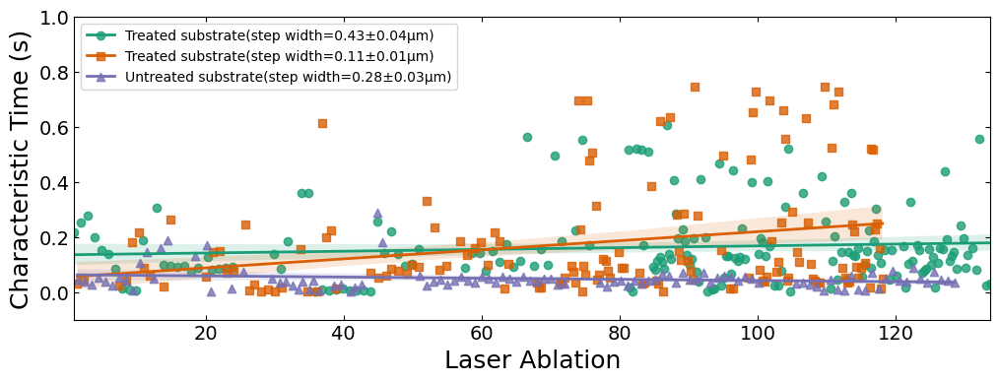

In [13]:
plt.rcParams.update(rc_plot)
titles = ['Treated substrate(step width=0.43±0.04μm)',
          'Treated substrate(step width=0.11±0.01μm)',
          'Untreated substrate(step width=0.28±0.03μm)']


fig, ax = plt.subplots(1, 1, figsize=(12, 4))
    
sns.regplot(ax=ax, x=x_test6_sklearn, y=tau_test6_sklearn, label=titles[0], 
            line_kws={'lw': 2, 'label': titles[0]},
            scatter=True, marker='o', color=color_green)
sns.regplot(ax=ax, x=x_test7_sklearn, y=tau_test7_sklearn, label=titles[1],
            line_kws={'lw': 2, 'label': titles[1]},
            scatter=True, marker='s', color=color_orange)
sns.regplot(ax=ax, x=x_test9_sklearn, y=tau_test9_sklearn, label=titles[2],
            line_kws={'lw': 2, 'label': titles[2]},
            scatter=True, marker='^', color=color_purple)
handles, labels = ax.get_legend_handles_labels()

n = 3
plt.legend(handles=[(h1, h2) for h1, h2 in zip(handles[:n], handles[n:])], labels=labels[n:], 
           fontsize=10)

plt.xlabel('Laser Ablation')
plt.ylabel('Characteristic Time (s)')
plt.ylim(-0.1, 1)
plt.savefig('../figures/4.linear_trend(sklearn).svg', bbox_inches='tight', dpi=300)
plt.show()